In [1]:
import cv2
import numpy as np
import numpy.fft as fft

from PIL import Image, ImageDraw, ImageFont

import matplotlib.pyplot as plt
from matplotlib import  rcParams

# inline显示图像
%matplotlib inline

rcParams['font.family'] = 'monospace'
rcParams['font.monospace'] = ['Ubuntu Mono', 'JetBrains Mono', 'Consolas', 'monospace']

In [2]:
def text_to_img(text, img_height):
    """ 文字转图片, 字体大小填充图片高度 """
    font = ImageFont.truetype('consola', img_height)
    img_width = int(font.getlength(text))
    img = Image.new('RGB', (img_width, img_height), (0, 0, 0))
    draw = ImageDraw.Draw(img)
    draw.text((0, 0), text, font=font, fill=(255, 255, 255))
    return np.array(img)


def load_water_mark(type: str, name: str, height: int = None):
    """ 载入适合频域的水印
    如果是 type 为 text 则生成内容为 name 的图片作为水印
    如果是 type 为 image 则载入目录下名称为 name 的图片作为水印, 将图片等比缩放至高度为 height """
    if type == 'text':
        wm = text_to_img(name, height)
    elif type == 'image':
        wm = cv2.imread(name)
        if height is not None:
            wm = cv2.resize(
                wm, (int(wm.shape[1] * height / wm.shape[0]), height))
    else:
        raise Exception('type must be text or image')
    return wm


def make_water_mark(target: np.ndarray, water_mark: np.ndarray, offset: tuple = (0, 0)):
    """ 制作水印
    创建 target 大小的图片 """
    wm = np.zeros(target.shape, dtype=np.uint8)
    # 制作
    wm[-water_mark.shape[0]-offset[0]:-offset[0],
       -water_mark.shape[1]-offset[1]:-offset[1]] = water_mark
    wm = wm[::-1, ::-1]
    wm[-water_mark.shape[0]-offset[0]:-offset[0],
       -water_mark.shape[1]-offset[1]:-offset[1]] = water_mark
    wm = wm[::-1, ::-1]
    return np.uint8(wm)


def show_images(images: list, titles: list, n: int, m: int, font_scale: float = 1, dpi: int = 800):
    """ 图像显示辅助函数
    并排显示 n * m 张图像, n 行 m 列
    在每张图左侧和顶侧显示像素坐标, 在每张图顶侧显示标题 """
    plt.figure(dpi=dpi)
    # 调整文字大小
    rcParams['font.size'] = 12 * font_scale
    for i in range(n):
        for j in range(m):
            plt.subplot(n, m, i * n + j + 1)
            plt.imshow(images[i * n + j], cmap='gray')
            plt.title(titles[i * n + j])
    plt.show()


def center_log_spectrum(spectrum: np.ndarray):
    """ 频谱中心化、对数化、归一化、* 255 """
    spectrum = np.log(np.abs(spectrum) + 1)
    spectrum = (spectrum - np.min(spectrum)) * \
        255 // (np.max(spectrum) - np.min(spectrum))
    return np.uint8(spectrum)

blocks = (32, 32, 3)

def text_to_img(text, img_height):
    font = ImageFont.truetype('consola', img_height)
    img_width = int(font.getlength(text))
    img = Image.new('RGB', (img_width, img_height), (0, 0, 0))
    draw = ImageDraw.Draw(img)
    draw.text((0, 0), text, font=font, fill=(255, 255, 255))
    return np.array(img)


def rgb_dct2(rgb_image: np.ndarray):
    '''
    对 rgb_image 作 dct 变换，返回频域图像
    '''
    return np.transpose([cv2.dct(np.float32(rgb_image[:, :, i])) for i in range(3)], axes=(1, 2, 0))


def rgb_idct2(rgb_image_dct: np.ndarray):
    '''
    对 rgb_image_dct 作逆 dct 变换，返回空域图像
    '''
    Img_idct2 = np.transpose([cv2.idct(rgb_image_dct[:, :, i]) for i in range(3)],
                             axes=(1, 2, 0))
    Img_idct2_qua = Img_idct2.copy()
    Img_idct2_qua[Img_idct2_qua > 255] = 255
    Img_idct2_qua[Img_idct2_qua <   0] = 0
    Img_idct2_qua = np.uint8(Img_idct2_qua)
    return Img_idct2_qua


def get_feature(Image: np.ndarray, blocks: tuple):
    '''
    对图像 Image 按 blocks 进行分块，返回每个块的最大值
    '''
    block_shape = (Image.shape[0]//blocks[0], Image.shape[1]//blocks[1])
    feature = np.zeros(
        shape=(blocks[0], blocks[1], 3))
    for i in range(feature.shape[0]):
        for j in range(feature.shape[1]):
            feature[i, j, :] = np.max(
                Image[block_shape[0]*i : block_shape[0]*(i+1),
                      block_shape[1]*j : block_shape[1]*(j+1),
                      :],
                axis=(0, 1))
    feature = np.uint8((feature - np.min(feature))*255 //
                       (np.max(feature) - np.min(feature)))
    return feature


def differ(img1_fea: np.ndarray, img2_fea: np.ndarray, return_pos=True):
    sum = 0
    position = []
    for i in range(img1_fea.shape[0]):
        for j in range(img1_fea.shape[1]):
            if (np.max(np.abs(img1_fea[i, j, :] - img2_fea[i, j, :])) > 100):
                sum += 1
                if (return_pos == True):
                    position.append((i, j))
    if (return_pos == True):
        return position, sum / (img1_fea.shape[0] * img1_fea.shape[1])
    else:
        return sum / (img1_fea.shape[0] * img1_fea.shape[1])


def extract(Image: np.ndarray, blocks: tuple):
    '''
    对图像 Image 按 blocks 进行分块，提取每个块的特征水印
    '''
    block_size = (Image.shape[0]//blocks[0], Image.shape[1]//blocks[1])
    wm_ext = np.zeros(shape=blocks)
    for i in range(blocks[0]):
        for j in range(blocks[1]):
            block = Image[i * block_size[0] : (i+1) * block_size[0],
                          j * block_size[1] : (j+1) * block_size[1], :]
            block_dct = rgb_dct2(block)
            wm_ext[i, j, :] = block_dct[-1, -1, :]
    return wm_ext


def mark_diff(Image: np.ndarray, position: list, blocks: tuple):
    '''
    在图像 Image 上用方框标记 position 对应的的块
    '''
    block_size = [Image.shape[0]//blocks[0], Image.shape[1]//blocks[1]]
    Image_marked = Image.copy()
    for pos in position:
        start_point = (pos[1] * block_size[1] + 2, pos[0] * block_size[0] + 2)
        end_point = (pos[1] * block_size[1] + block_size[1] - 2, pos[0] * block_size[0] + block_size[0] - 2)
        cv2.rectangle(Image_marked, start_point, end_point,
                      (0, 0, 255), thickness=2, lineType=cv2.LINE_8)
    return Image_marked


Read RGB Image and Generate watermark

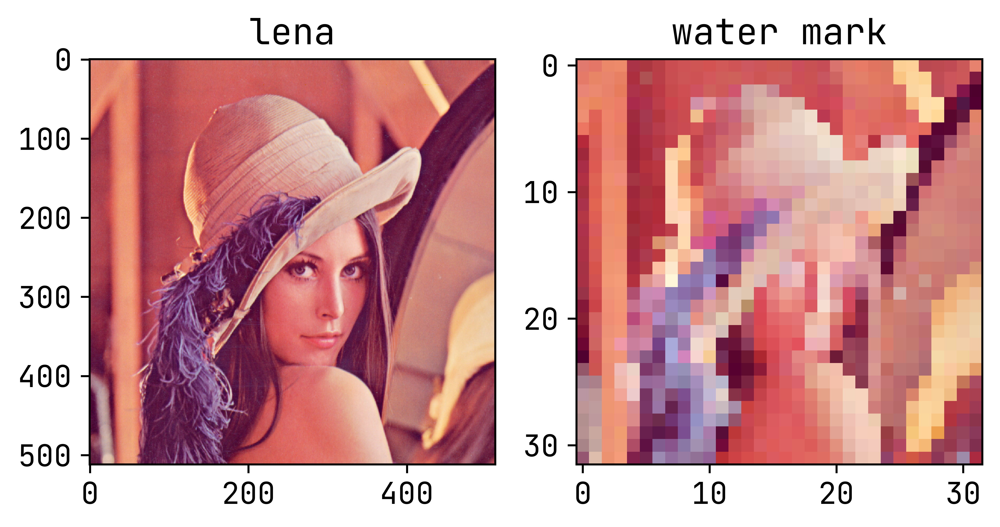

In [3]:
# 读取 lena rgb 位图 LenaRGB.bmp，通道顺序 (b,g,r)
img_bgr = cv2.imread('LenaRGB.bmp', cv2.IMREAD_COLOR)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

block_size = img_rgb.shape[0]//blocks[0], img_rgb.shape[1]//blocks[1]

# 载入水印
wm_ori = get_feature(img_rgb, blocks)

show_images([img_rgb, wm_ori], ['lena', 'water mark'], 1, 2)

Load watermark

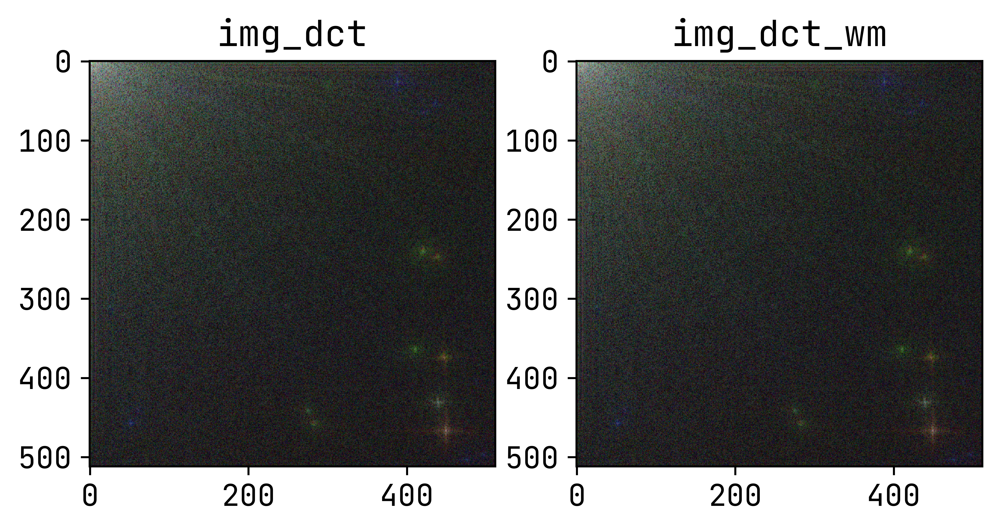

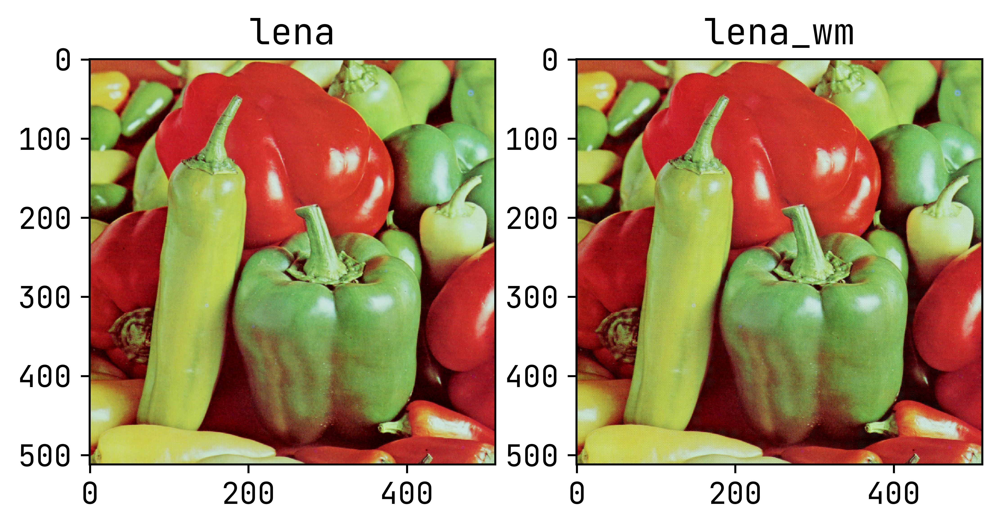

Extracted feature and original feature differs : 0.000000


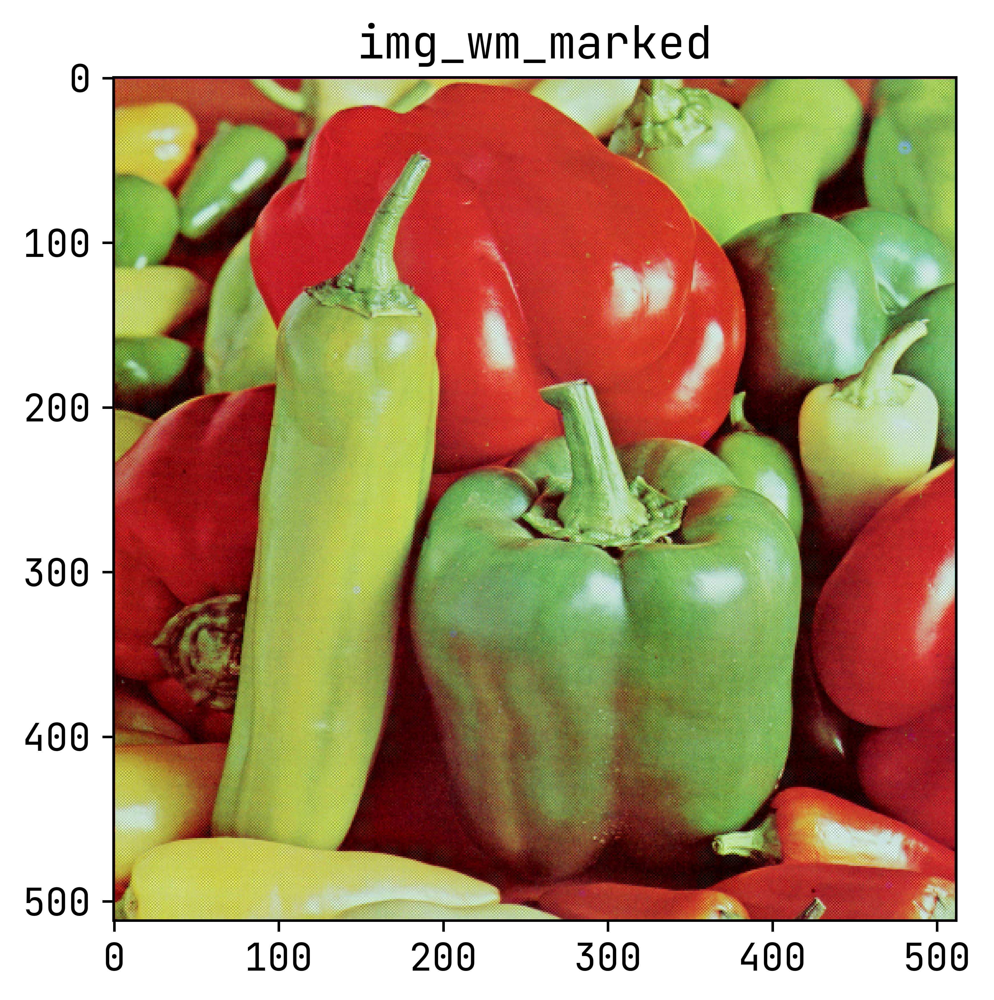

True

In [4]:
img_bgr = cv2.imread('PeppersRGB.bmp', cv2.IMREAD_COLOR)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 载入水印
wm_ori = get_feature(img_rgb, blocks)

img_dct = rgb_dct2(img_rgb)

img_dct_wm = img_dct.copy()

img_wm = img_rgb.copy()

# add watermark
for i in range(wm_ori.shape[0]):
    for j in range(wm_ori.shape[1]):
        block = img_rgb[i * block_size[0] : (i+1) * block_size[0],
                        j * block_size[1] : (j+1) * block_size[1], :]
        block_dct = rgb_dct2(block)
        block_dct[-1, -1, :] = wm_ori[i, j, :]
        img_wm[i * block_size[0] : (i+1) * block_size[0],
               j * block_size[1] : (j+1) * block_size[1], :] = rgb_idct2(block_dct)
show_images([center_log_spectrum(img_dct), center_log_spectrum(img_dct_wm)],
            ['img_dct', 'img_dct_wm'], 1, 2)

# compare img_wm_fea and fea_ext
fea_ext = extract(img_wm, blocks)
show_images([img_rgb, img_wm], ['lena', 'lena_wm'], 1, 2)
img_wm_fea = get_feature(img_wm, blocks)
pos, diff = differ(img_wm_fea, fea_ext)
print("Extracted feature and original feature differs : %f" % (diff))

img_wm_marked = mark_diff(img_wm, pos, blocks)
show_images([img_wm_marked], ['img_wm_marked'], 1, 1)

# 导出结果到 PNG
img_wm_marked = cv2.cvtColor(img_wm_marked, cv2.COLOR_RGB2BGR)
cv2.imwrite('lena_wm_marked.png', img_wm_marked)


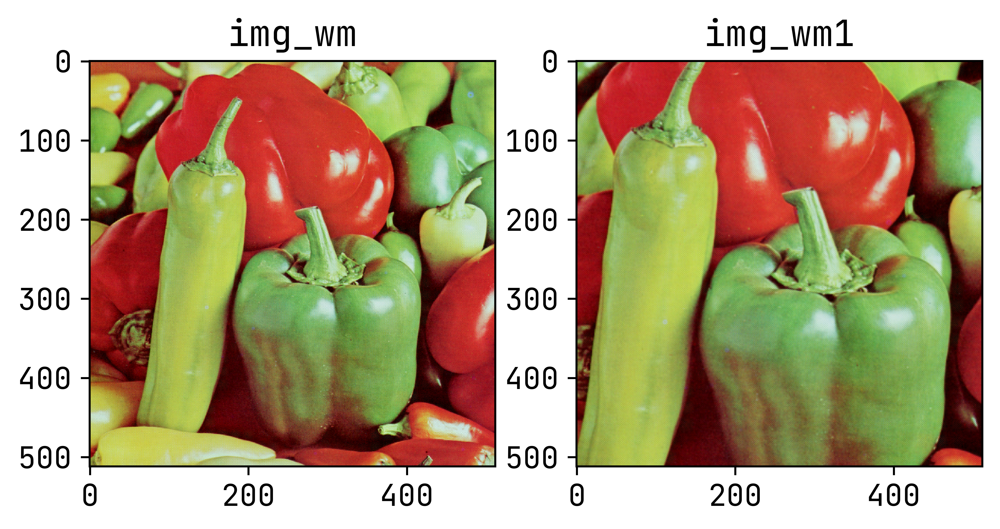

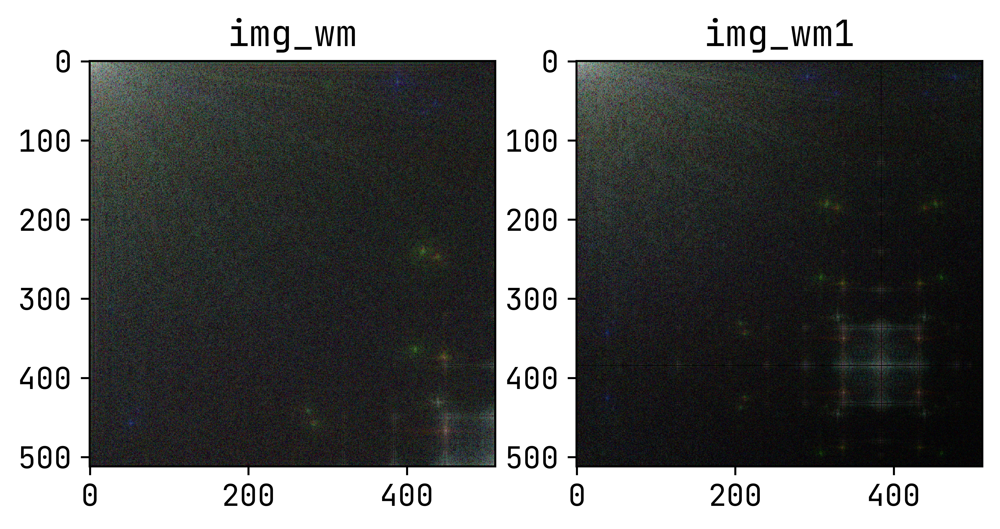

Extracted feature and original feature differs : 0.982422


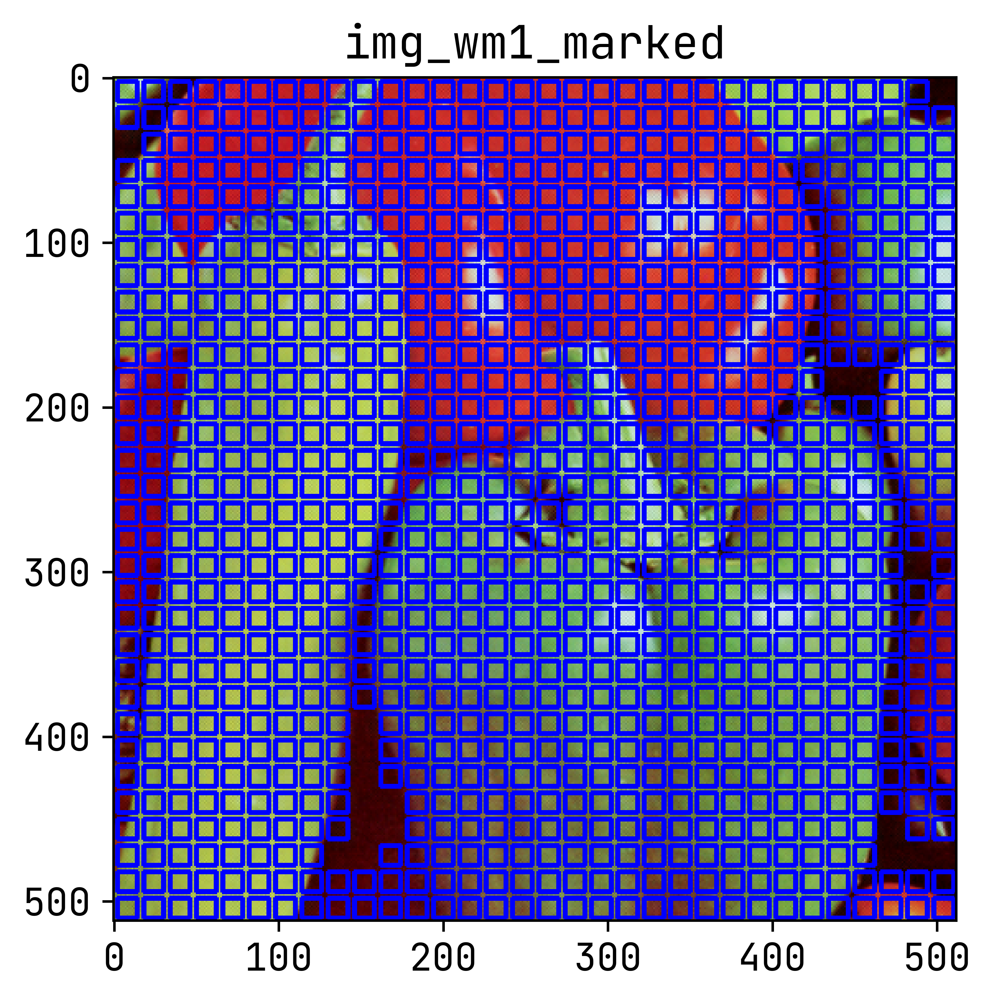

In [5]:
# cut and resize
img_wm1 = img_wm.copy()
img_wm1 = img_wm1[64:-64, 64:-64]
img_wm1 = cv2.resize(img_wm1,(512,512))

wm1_fea = get_feature(img_wm1,blocks)
fea_ext1 = extract(img_wm1,blocks)
show_images([img_wm,img_wm1],['img_wm','img_wm1'],1,2)
show_images([center_log_spectrum(rgb_dct2(img_wm)),center_log_spectrum(rgb_dct2(img_wm1))],['img_wm','img_wm1'],1,2)
pos,diff = differ(fea_ext1,wm1_fea)
print("Extracted feature and original feature differs : %f"%(diff))
img_wm1_marked = mark_diff(img_wm1,pos,blocks)
show_images([img_wm1_marked],['img_wm1_marked'],1,1)

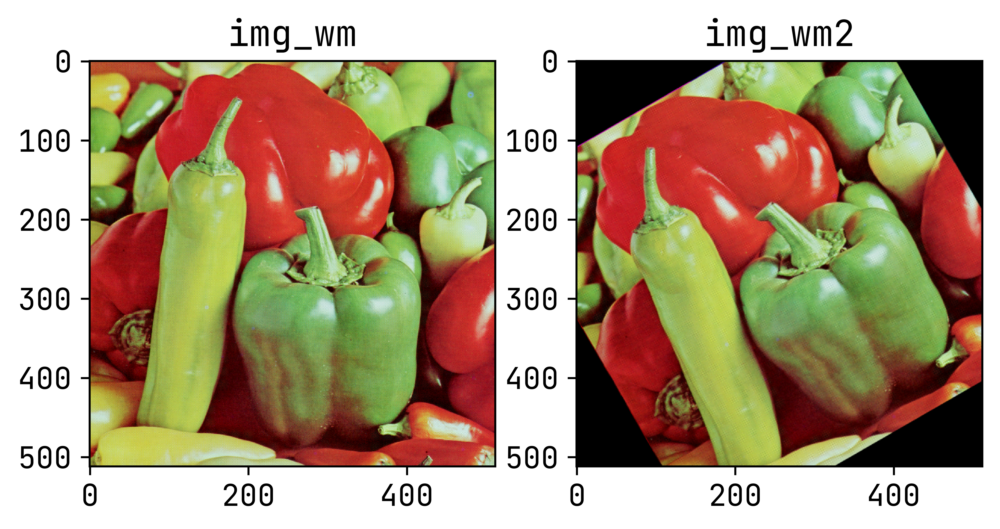

Extracted feature and original feature differs : 0.906250


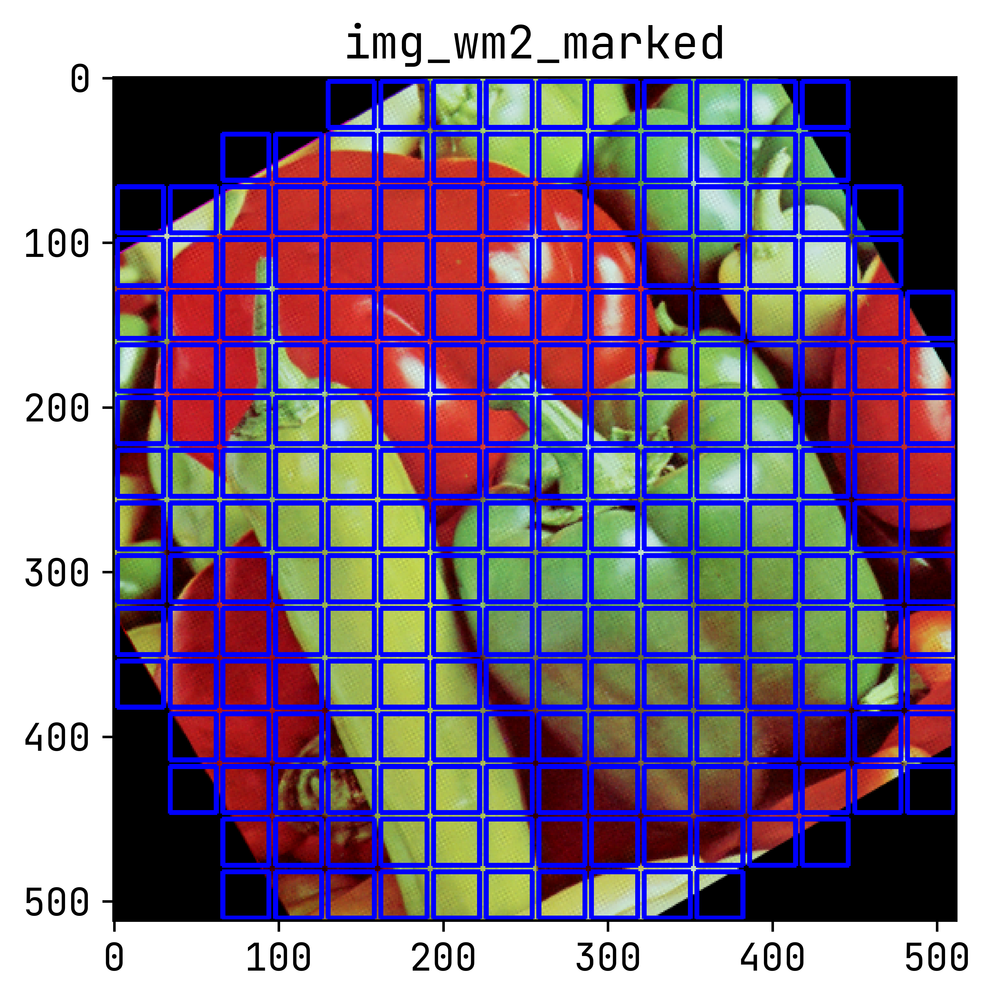

In [6]:
# rotate
img_wm2 = img_wm.copy()
img_wm2 = cv2.warpAffine(img_wm2, cv2.getRotationMatrix2D((img_wm2.shape[1] // 2, img_wm2.shape[0] // 2), 30, 1), (img_wm2.shape[1], img_wm2.shape[0]))
fea_ext2 = extract(img_wm2,(16,16,3))
show_images([img_wm,img_wm2],['img_wm','img_wm2'],1,2)
pos,diff = differ(fea_ext2,get_feature(img_wm2,block_size))
print("Extracted feature and original feature differs : %f"%(diff))

img_wm2_marked = mark_diff(img_wm2,pos,block_size)
show_images([img_wm2_marked],['img_wm2_marked'],1,1)

In [7]:
# cover
img_wm4 = img_wm.copy()
new_mark = load_water_mark(img_wm4,'text', 'mc#&*s9jk%%f&', 64)
x1 = img_wm.shape[0] // 2 - new_mark.shape[0] // 2
x2 = x1 + new_mark.shape[0]
y1 = img_wm.shape[1] // 2 - new_mark.shape[1] // 2
y2 = y1 + new_mark.shape[1]
img_wm4[x1:x2, y1:y2] = np.uint64(img_wm4[x1:x2, y1:y2]) * (1 + np.uint64(new_mark))
img_wm4[y1:y2, x1:x2] = np.uint64(img_wm4[y1:y2, x1:x2]) * (1 + np.transpose(np.uint64(new_mark),(1,0,2)))
img_wm4[img_wm4 > 255] = 255
img_wm4[img_wm4 < 0] = 0
img_wm4 = np.uint8(img_wm4)

fea_ext3 = extract(img_wm4,blocks)
show_images([img_wm,img_wm4],['img_wm','img_wm4'],1,2)
pos,diff = differ(get_feature(img_wm4,blocks),fea_ext3)
print("Extracted feature and original feature differs : %f"%(diff))
img_wm4_marked = mark_diff(img_wm4,pos,blocks)
show_images([img_wm4_marked],['img_wm4_marked'],1,1)

TypeError: load_water_mark() takes from 2 to 3 positional arguments but 4 were given

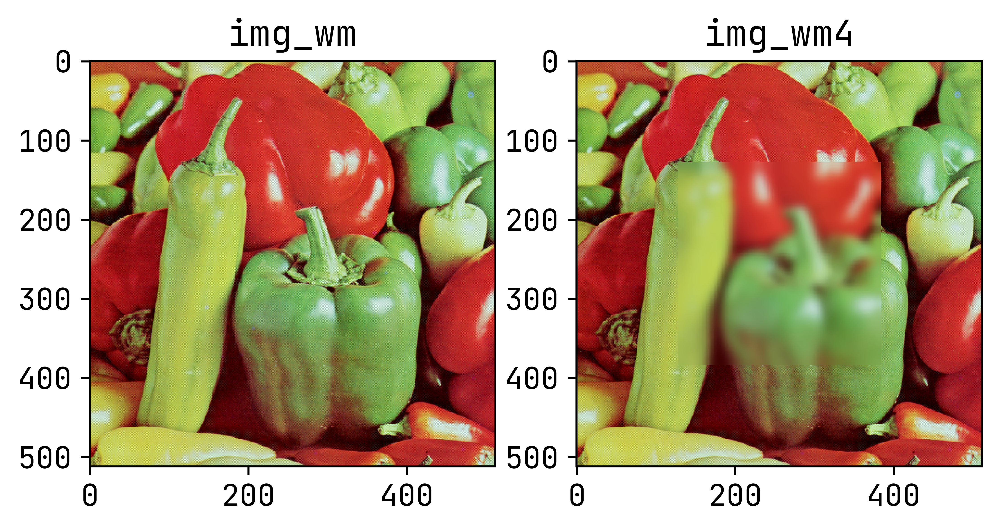

Extracted feature and original feature differs : 0.249023


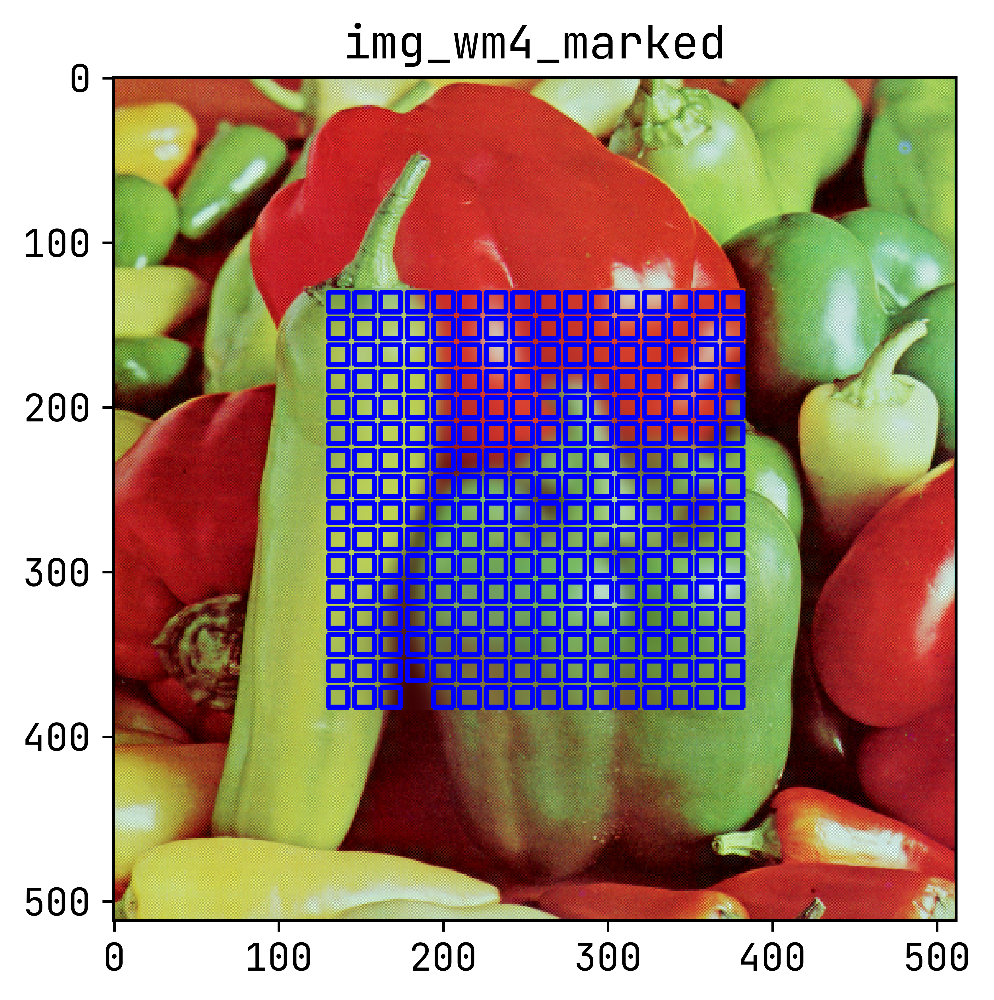

In [ ]:
# Gaussian Blur (Fail to detect)

img_wm4 = img_wm.copy()

img_wm4[img_wm4.shape[0]//2-BLUR_SIZE:img_wm4.shape[0]//2+BLUR_SIZE, img_wm4.shape[1]//2-BLUR_SIZE:img_wm4.shape[1]//2+BLUR_SIZE] = \
    cv2.GaussianBlur(img_wm4[img_wm4.shape[0]//2-BLUR_SIZE:img_wm4.shape[0]//2+BLUR_SIZE, img_wm4.shape[1]//2-BLUR_SIZE:img_wm4.shape[1]//2+BLUR_SIZE], (33, 33), 0)

fea_ext4 = extract(img_wm4,blocks)
wm_fea4 = get_feature(img_wm4,blocks)
show_images([img_wm,img_wm4],['img_wm','img_wm4'],1,2)
pos,diff = differ(wm_fea4,fea_ext4)
print("Extracted feature and original feature differs : %f"%(diff))
img_wm4_marked = mark_diff(img_wm4,pos,blocks)
show_images([img_wm4_marked],['img_wm4_marked'],1,1)

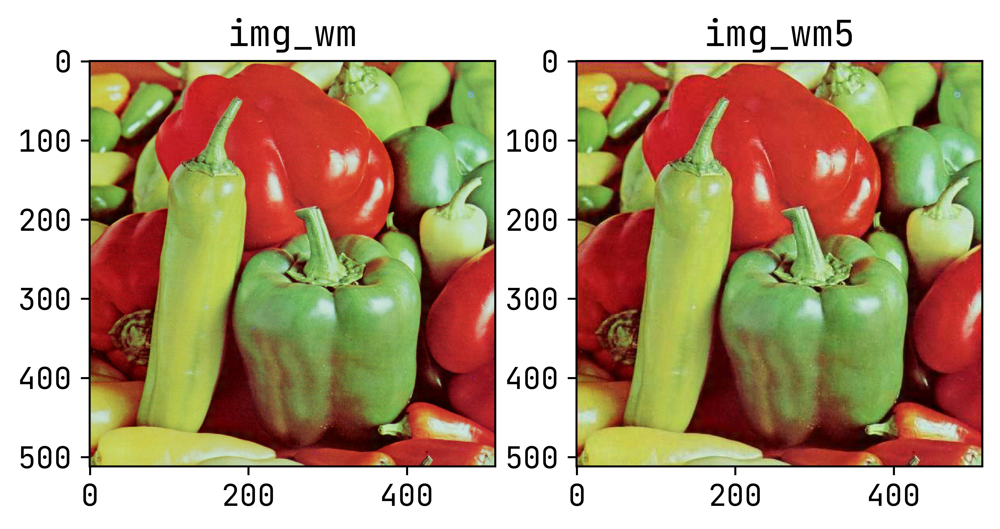

Extracted feature and original feature differs : 0.458008


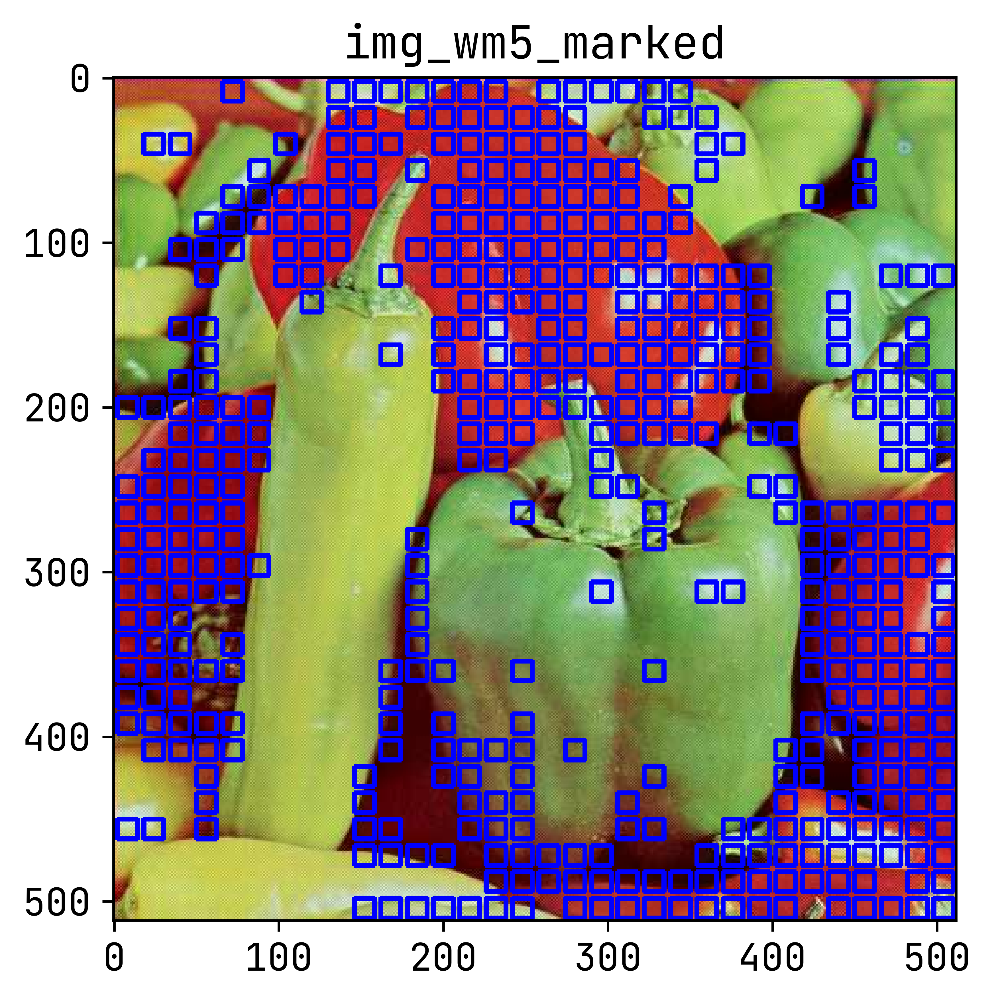

In [ ]:
# compression

img_wm5 = img_wm.copy()
# 将 img_wm 进行 jpeg 压缩
cv2.imwrite('tmp.jpg', img_wm5, [int(cv2.IMWRITE_JPEG_QUALITY), 50])
img_wm5 = cv2.imread('tmp.jpg')

fea_ext5 = extract(img_wm5,blocks)
wm_fea5 = get_feature(img_wm5,blocks)
show_images([img_wm,img_wm5],['img_wm','img_wm5'],1,2)
pos,diff = differ(wm_fea5, fea_ext5)
print("Extracted feature and original feature differs : %f"%(diff))
img_wm5_marked = mark_diff(img_wm5,pos,blocks)
show_images([img_wm5_marked],['img_wm5_marked'],1,1)

